In [1]:
import os, sys

sys.path.append(
    os.path.dirname(os.getcwd())
)
import json
from pprint import pprint
from glob import glob
import numpy as np
import matplotlib.pyplot as plt
import cv2

import trimesh
import plotly.graph_objects as go
import PIL
from PIL import Image

import pygarment as pyg

from analysis_utils import (
    set_constants,
    # visualize_meshes_plotly,
    euler_angles_to_rotation_matrix,
    plot_panel_info,
    v_id_map
)




def visualize_meshes_plotly(
    mesh_list,
    color_list=None,
    vertices_list = None,
    vertices_color_list = None,
    vertex_marker_size = 2,
    show_edges = True,
    edge_width = 2,
):
    # Pre-convert to list and load meshes once
    mesh_list = [mesh_list] if not isinstance(mesh_list, list) else mesh_list
    final_mesh_list = [trimesh.load(m) if isinstance(m, str) else m for m in mesh_list]
    
    color_list = color_list or ['lightgray'] * len(final_mesh_list)
    
    # Create all mesh traces at once
    mesh_traces = []
    edge_traces = []
    for mesh, color in zip(final_mesh_list, color_list):
        face_colors = mesh.visual.face_colors[:, :3] if hasattr(mesh.visual, 'face_colors') else None
        mesh_traces.append(go.Mesh3d(
            x=mesh.vertices[:, 0],
            y=mesh.vertices[:, 1],
            z=mesh.vertices[:, 2],
            i=mesh.faces[:, 0],
            j=mesh.faces[:, 1],
            k=mesh.faces[:, 2],
            opacity=0.5,
            facecolor=face_colors,
            color=None if face_colors is not None else color
        ))
        
        if show_edges:
            edge_x = []
            edge_y = []
            edge_z = []
            vertices = mesh.vertices
            for edge in mesh.edges:
                edge_x.extend([vertices[edge[0], 0], vertices[edge[1], 0], None])
                edge_y.extend([vertices[edge[0], 1], vertices[edge[1], 1], None])
                edge_z.extend([vertices[edge[0], 2], vertices[edge[1], 2], None])
        
            edge_traces.append(go.Scatter3d(
                x=edge_x, y=edge_y, z=edge_z,
                mode='lines',
                line=dict(
                    color = color if color is not None else 'red',
                    width=edge_width
                ),
                name='Edges'
            ))
    
    fig = go.Figure(data = mesh_traces + edge_traces)
    
    if vertices_list is not None and vertices_color_list is not None:
        for vertex, color in zip(vertices_list, vertices_color_list):
            fig.add_trace(go.Scatter3d(
                x=vertex[:, 0],
                y=vertex[:, 1],
                z=vertex[:, 2],
                mode='markers',
                marker=dict(size=vertex_marker_size, color=color, opacity=1),
                name='Vertices'
            ))
            fig.add_trace(go.Scatter3d(
                x=vertex[:, 0],
                y=vertex[:, 1],
                z=vertex[:, 2],
                mode='lines',
                line=dict(color=color, width=2),
                name='Polyline'
            ))
    fig.update_layout(
        scene=dict(aspectmode='data'),
        width=800,
        height=800,
        showlegend=False
    )
    
    fig.show()




DATASET_ROOT = set_constants()

GARMENT_ROOT_PATH = os.path.join(DATASET_ROOT, "GarmentCodeData_v2")
BODY_ROOT_PATH = os.path.join(DATASET_ROOT, "body_mesh")
MEAN_ALL_BODY_PATH = os.path.join(DATASET_ROOT, "neutral_body/mean_all.obj")

default_body_mesh = trimesh.load(MEAN_ALL_BODY_PATH)


# BODY_TYPE = "random_body"
BODY_TYPE = "default_body"

garment_path_list = sorted(list(filter(
    os.path.isdir,
    glob(os.path.join(GARMENT_ROOT_PATH, "*", BODY_TYPE, "*"))
)))

len(garment_path_list)

132670

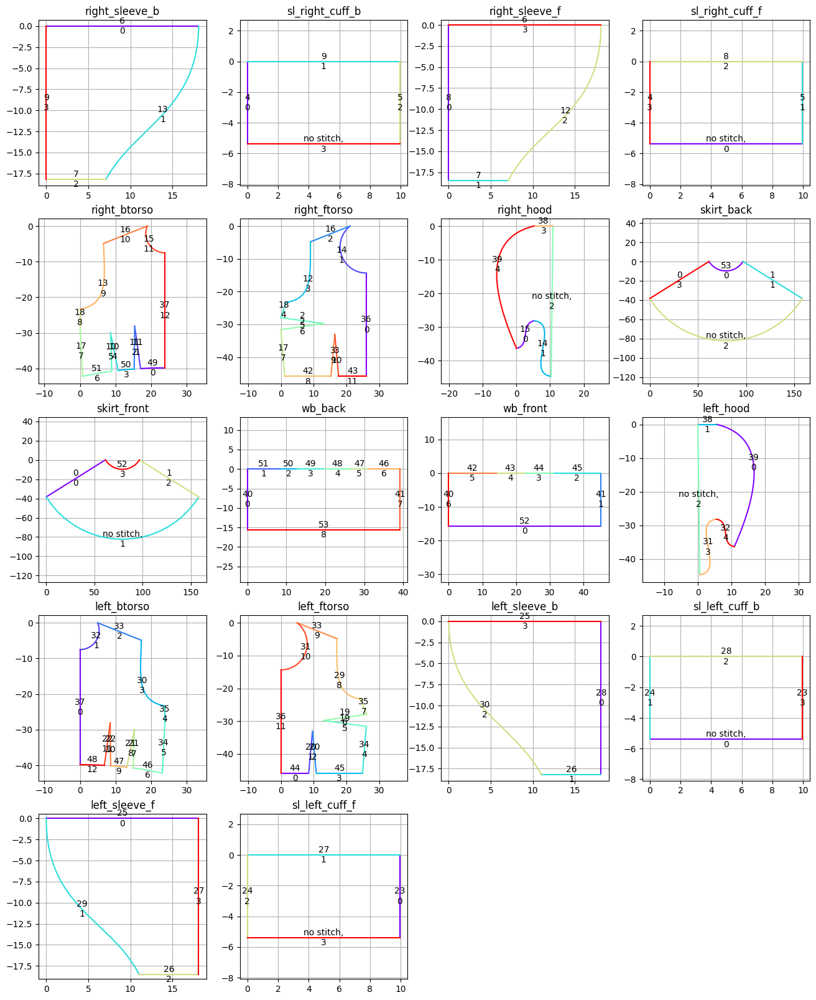

In [2]:
IDX = 0

garment_path = garment_path_list[IDX]
garment_id = os.path.basename(garment_path)
SPEC_FILE_PATH = os.path.join(garment_path, f"{garment_id}_specification.json")
pattern = pyg.pattern.wrappers.VisPattern(SPEC_FILE_PATH)

# Get Garment Blueprint
panel_svg_path_dict = {
    panel_name : pattern._draw_a_panel(
        panel_name, apply_transform=False, fill=True
    )
    for panel_name in pattern.panel_order()
}
stitch_dict = {
    i : v for i, v in enumerate(pattern.pattern['stitches'])
}

FIGLEN = 4
NCOLS = int(np.sqrt(len(panel_svg_path_dict)))
NROWS = int(np.ceil(len(panel_svg_path_dict) / NCOLS))

plt.figure(figsize=(FIGLEN * NCOLS, FIGLEN * NROWS))
for i, (panel_name, panel) in enumerate(panel_svg_path_dict.items()):
    ax = plt.subplot(NROWS, NCOLS, i + 1)
    ax.set_title(panel_name)
    plot_panel_info(
        ax, panel_name, panel_svg_path_dict, stitch_dict,
        N_SAMPLES=1000
    )
# plt.savefig(f"{garment_id}_panel_vis.png")
plt.show()

In [3]:
# panel_svg_path_dict = {
#     panel_name : pattern._draw_a_panel(
#         panel_name, apply_transform=False, fill=True
#     )
#     for panel_name in pattern.panel_order()
# }
# pattern.get_svg(panel_svg_path_dict)

In [4]:
# drawing panel annotations
# for panel_name in panel_svg_path_dict.keys():
#     pattern._add_panel_annotations(drawing,panel_svg_path_dict[panel_name][0], panel_name)


In [5]:
SPEC_FILE_PATH


'/media/hjp/05aba9a7-0e74-4e54-9bc9-5f11b9c4c757/GarmentCodeData/GarmentCodeData_v2/garments_5000_0/default_body/rand_00YONAPXZE/rand_00YONAPXZE_specification.json'

In [6]:
#pattern._add_panel_annotations(drawing,panel_svg_path_dict[panel_name][0], panel_name)
# panel_svg_path_dict['skirt_front']
DIR = SPEC_FILE_PATH

with open(DIR, "r") as f:
    spec = json.load(f)

print(f"SVG_PATH : {panel_svg_path_dict['skirt_front']}")
print(f"JSON_PATH : {spec['pattern']['panels']['skirt_front']['vertices']}")


SVG_PATH : (Path(Line(start=(61.454838977496586+0j), end=38.38062562742405j),
     Arc(start=38.38062562742405j, radius=(93.27779024461488+93.27779024461488j), rotation=0, large_arc=False, sweep=False, end=(158.23195925485862+38.38062562742405j)),
     Line(start=(158.23195925485862+38.38062562742405j), end=(96.77712027736203+0j)),
     Arc(start=(96.77712027736203+0j), radius=(20.822496046726815+20.822496046726815j), rotation=0, large_arc=False, sweep=True, end=(61.454838977496586+0j))), {'fill': 'rgb(227,175,186)', 'stroke': 'rgb(51,51,51)', 'stroke-width': '0.2'}, True)
JSON_PATH : [[-0.6611406499327259, 0], [-62.11597962742931, -38.38062562742405], [96.11597962742931, -38.38062562742405], [34.661140649932726, 0]]


In [7]:
# TODO: 내가 변환해본 부분.

import os
import numpy as np
import trimesh
import json

# Function to transform vertices based on rotation and translation
def transform_vertices(path, euler_angles, translation):
    # Extract and flip Y-axis for SVG coordinates
    vertices = np.array(list(map(
        lambda edge: [edge.start.real, -edge.start.imag],  # Y-axis flip
        path
    )))
    
    # Close the loop for the panel
    vertices = np.vstack([vertices, vertices[0]])

    # Add Z-axis and apply transformations
    rotation_matrix = euler_angles_to_rotation_matrix(euler_angles)
    transformed_vertices = np.hstack([
        vertices,
        np.zeros((vertices.shape[0], 1))  # Add Z-axis
    ]) @ rotation_matrix.T + translation

    return transformed_vertices

# Load box mesh
box_mesh = trimesh.load_mesh(
    os.path.join(garment_path, f"{garment_id}_boxmesh.ply"),
    process=False
)

# Map vertex indices
idx_convert_map = v_id_map(box_mesh.vertices)
idx_convert_map_arr = np.array(idx_convert_map)

# Read segmentation file
with open(os.path.join(garment_path, f"{garment_id}_sim_segmentation.txt"), "r") as f:
    segmentation = list(map(lambda x: x.strip(), f.readlines()))

# Create stitch vertex mask
stitch_vertex_mask_dict = {}
for k in stitch_dict.keys():
    raw_mask = list(map(
        lambda x: True if f"stitch_{k}" in x.split(",") else False,
        segmentation
    ))
    base_mask = np.array(list(map(
        lambda idx: True if raw_mask[idx] else False,
        idx_convert_map
    )))
    stitch_vertex_mask_dict[k] = base_mask

# Load JSON specification
with open(SPEC_FILE_PATH, "r") as f:
    spec = json.load(f)

# Transform panel vertices and collect for visualization
lifted_panel_vertex_arr_list = []
for panel_name, panel in panel_svg_path_dict.items():
    path = panel[0]
    euler_angles = spec['pattern']['panels'][panel_name]['rotation']
    translation = spec['pattern']['panels'][panel_name]['translation']

    # Transform vertices
    panel_vertex_arr = transform_vertices(path, euler_angles, translation)
    lifted_panel_vertex_arr_list.append(panel_vertex_arr)

# Visualize the mesh and transformed panels
visualize_meshes_plotly(
    [box_mesh],
    show_edges=False,
    vertices_list=lifted_panel_vertex_arr_list + list(map(
        lambda mask: box_mesh.vertices[mask],
        stitch_vertex_mask_dict.values()
    )),
    vertices_color_list=[
        "black"
    ] * len(lifted_panel_vertex_arr_list) + [
        "yellow"
    ] * len(stitch_vertex_mask_dict.values())
)

In [ ]:
#CROSS CHECK Vertex JSON SVP PATH START END POINT 



In [8]:
import svgpathtools as svgpath
from pygarment.pattern import utils

def _flip_y(point):
    """
        To get to image coordinates one might need to flip Y axis
    """
    flipped_point = list(point)  # top-level copy
    flipped_point[1] *= -1
    return flipped_point

def _edge_as_curve(vertices, edge):
    start = vertices[edge['endpoints'][0]]
    end = vertices[edge['endpoints'][1]]
    if ('curvature' in edge):
        # NOTE: supports old curves
        if isinstance(edge['curvature'], list) or edge['curvature']['type'] == 'quadratic':  
            control_scale = _flip_y(edge['curvature'] if isinstance(edge['curvature'], list) else edge['curvature']['params'][0])
            control_point = utils.rel_to_abs_2d(start, end, control_scale)
            return svgpath.QuadraticBezier(*utils.list_to_c([start, control_point, end]))
        elif edge['curvature']['type'] == 'circle':  # Assuming circle
            # https://svgwrite.readthedocs.io/en/latest/classes/path.html#svgwrite.path.Path.push_arc

            radius, large_arc, right = edge['curvature']['params']

            return svgpath.Arc(
                utils.list_to_c(start), radius + 1j*radius,
                rotation=0,
                large_arc=large_arc, 
                sweep=not right,
                end=utils.list_to_c(end)
            )

        elif edge['curvature']['type'] == 'cubic':
            cps = []
            for p in edge['curvature']['params']:
                control_scale = _flip_y(p)
                control_point = utils.rel_to_abs_2d(start, end, control_scale)
                cps.append(control_point)

            return svgpath.CubicBezier(*utils.list_to_c([start, *cps, end]))

        else:
            raise ValueError(f'Unknown curvature type {edge["curvature"]["type"]}')

    else:
        return svgpath.Line(*utils.list_to_c([start, end]))


garment_id = os.path.basename(garment_path)
SPEC_FILE_PATH = os.path.join(garment_path, f"{garment_id}_specification.json")
pattern = pyg.pattern.wrappers.VisPattern(SPEC_FILE_PATH)

box_mesh = trimesh.load_mesh(
    os.path.join(garment_path, f"{garment_id}_boxmesh.ply"),
    process=False
)
idx_convert_map = v_id_map(box_mesh.vertices)
idx_convert_map_arr = np.array(idx_convert_map)

# Read Vertex Label
with open(os.path.join(garment_path, f"{garment_id}_sim_segmentation.txt"), "r") as f:
    segmentation = list(map(
        lambda x : x.strip(),
        f.readlines()
    ))

stitch_vertex_mask_dict = {}
for k in stitch_dict.keys():
    raw_mask = list(map(
        lambda x : True if f"stitch_{k}" in x.split(",") else False,
        segmentation
    ))
    base_mask = np.array(list(map(
        lambda idx : True if raw_mask[idx] else False,
        idx_convert_map
    )))
    stitch_vertex_mask_dict[k] = base_mask

with open(SPEC_FILE_PATH, "r") as f:
    spec = json.load(f)

lifted_panel_vertex_arr_list = []
# bbox_center_list = []
# for panel_name, panel in panel_svg_path_dict.items():
for panel_name, panel in spec['pattern']['panels'].items():

    euler_angles = spec['pattern']['panels'][panel_name]['rotation']
    translation = spec['pattern']['panels'][panel_name]['translation']
    rotation_matrix = euler_angles_to_rotation_matrix(euler_angles)

    vertices = np.asarray(panel['vertices'])
    segs = [_edge_as_curve(vertices, edge) for edge in panel['edges']]
    path = svgpath.Path(*segs)
    
    x1, x2, y1, y2 = path.bbox()
    xm = (x1 + x2) / 2
    ym = (y1 + y2) / 2 
    
    vertices = np.array(list(map(
        lambda edge : [edge.start.real, edge.start.imag],
        path
    )))
    vertices = np.vstack([
        vertices,
        vertices[0], # add start point to close the loop
        [xm, ym] # add center point to close the loop
    ])
    
    panel_vertex_arr = np.hstack([
        vertices,
        np.zeros((vertices.shape[0], 1))
    ]) @ rotation_matrix.T + translation
    
    lifted_panel_vertex_arr_list.append(panel_vertex_arr)

visualize_meshes_plotly(
    [box_mesh],
    show_edges=False,
    vertices_list=lifted_panel_vertex_arr_list + list(map(
        lambda mask : box_mesh.vertices[mask],
        stitch_vertex_mask_dict.values()
    )),

    vertices_color_list=[
        "black"
    ] * len(lifted_panel_vertex_arr_list) + [
        "yellow"
    ] * len(stitch_vertex_mask_dict.values())
)

In [9]:
garment_id = os.path.basename(garment_path)
SPEC_FILE_PATH = os.path.join(garment_path, f"{garment_id}_specification.json")

with open(SPEC_FILE_PATH, "r") as f:
    spec = json.load(f)
    
pattern = pyg.pattern.wrappers.VisPattern(SPEC_FILE_PATH)

# Get Garment Blueprint
panel_svg_path_dict = {
    panel_name : pattern._draw_a_panel(
        panel_name, apply_transform=False, fill=True
    )
    for panel_name in pattern.panel_order()
}
stitch_dict = {
    i : v for i, v in enumerate(pattern.pattern['stitches'])
}

box_mesh = trimesh.load_mesh(
    os.path.join(garment_path, f"{garment_id}_boxmesh.ply"),
    process=False
)
idx_convert_map = v_id_map(box_mesh.vertices)
idx_convert_map_arr = np.array(idx_convert_map)

# Read Vertex Label
with open(os.path.join(garment_path, f"{garment_id}_sim_segmentation.txt"), "r") as f:
    segmentation = list(map(
        lambda x : x.strip(),
        f.readlines()
    ))

stitch_vertex_mask_dict = {}
for k in stitch_dict.keys():
    raw_mask = list(map(
        lambda x : True if f"stitch_{k}" in x.split(",") else False,
        segmentation
    ))
    base_mask = np.array(list(map(
        lambda idx : True if raw_mask[idx] else False,
        idx_convert_map
    )))
    stitch_vertex_mask_dict[k] = base_mask


lifted_panel_vertex_arr_list = []
# bbox_center_list = []
for panel_name, panel in panel_svg_path_dict.items():
# for panel_name, panel in spec['pattern']['panels'].items():
    vertices_from_spec = np.asarray(spec['pattern']['panels'][panel_name]['vertices'])    
    offset = np.min(vertices_from_spec * np.array([1, -1]), axis=0)

    euler_angles = spec['pattern']['panels'][panel_name]['rotation']
    translation = spec['pattern']['panels'][panel_name]['translation']
    rotation_matrix = euler_angles_to_rotation_matrix(euler_angles)

    path = panel[0]
    
    x1, x2, y1, y2 = path.bbox()
    xm = (x1 + x2) / 2
    ym = (y1 + y2) / 2 

    vertices_from_svg = np.array(list(map(
        lambda edge : [edge.start.real, edge.start.imag],
        path
    )))
    vertices = np.vstack([
        vertices_from_svg,
        vertices_from_svg[0], # add start point to close the loop
        [xm, ym] # add center point to close the loop
    ])
    
    vertices = (vertices + offset) * np.array([1, -1])
    
    panel_vertex_arr = np.hstack([
        vertices,
        np.zeros((vertices.shape[0], 1))
    ]) @ rotation_matrix.T + translation
    
    lifted_panel_vertex_arr_list.append(panel_vertex_arr)

visualize_meshes_plotly(
    [box_mesh],
    show_edges=False,
    vertices_list=lifted_panel_vertex_arr_list + list(map(
        lambda mask : box_mesh.vertices[mask],
        stitch_vertex_mask_dict.values()
    )),

    vertices_color_list=[
        "black"
    ] * len(lifted_panel_vertex_arr_list) + [
        "yellow"
    ] * len(stitch_vertex_mask_dict.values())
)

In [61]:
garment_id = os.path.basename(garment_path)
SPEC_FILE_PATH = os.path.join(garment_path, f"{garment_id}_specification.json")

with open(SPEC_FILE_PATH, "r") as f:
    spec = json.load(f)
    
pattern = pyg.pattern.wrappers.VisPattern(SPEC_FILE_PATH)

# Get Garment Blueprint
panel_svg_path_dict = {
    panel_name : pattern._draw_a_panel(
        panel_name, apply_transform=False, fill=True
    )
    for panel_name in pattern.panel_order()
}
stitch_dict = {
    i : v for i, v in enumerate(pattern.pattern['stitches'])
}

box_mesh = trimesh.load_mesh(
    os.path.join(garment_path, f"{garment_id}_boxmesh.ply"),
    process=False
)
idx_convert_map = v_id_map(box_mesh.vertices)
idx_convert_map_arr = np.array(idx_convert_map)

# Read Vertex Label
with open(os.path.join(garment_path, f"{garment_id}_sim_segmentation.txt"), "r") as f:
    segmentation = list(map(
        lambda x : x.strip(),
        f.readlines()
    ))

stitch_vertex_mask_dict = {}
for k in stitch_dict.keys():
    raw_mask = list(map(
        lambda x : True if f"stitch_{k}" in x.split(",") else False,
        segmentation
    ))
    base_mask = np.array(list(map(
        lambda idx : True if raw_mask[idx] else False,
        idx_convert_map
    )))
    stitch_vertex_mask_dict[k] = base_mask


lifted_panel_vertex_arr_list = []
# bbox_center_list = []
for panel_name, panel in panel_svg_path_dict.items():
# for panel_name, panel in spec['pattern']['panels'].items():
    vertices_from_spec = np.asarray(spec['pattern']['panels'][panel_name]['vertices'])    
    offset = np.min(vertices_from_spec * np.array([1, -1]), axis=0)

    euler_angles = spec['pattern']['panels'][panel_name]['rotation']
    translation = spec['pattern']['panels'][panel_name]['translation']
    rotation_matrix = euler_angles_to_rotation_matrix(euler_angles)

    path = panel[0]
    
    x1, x2, y1, y2 = path.bbox()
    xm = (x1 + x2) / 2
    ym = (y1 + y2) / 2 

    vertices_from_svg = np.array(list(map(
        lambda edge : [edge.start.real, edge.start.imag],
        path
    )))

    vertices = np.vstack([
        vertices_from_svg,
        vertices_from_svg[0], # add start point to close the loop
        [xm, ym] # add center point to close the loop
    ])
    vertices = (vertices - offset) * np.array([1, -1])
    
    panel_vertex_arr = np.hstack([
        vertices,
        np.zeros((vertices.shape[0], 1))
    ]) @ rotation_matrix.T + translation
    
    lifted_panel_vertex_arr_list.append(panel_vertex_arr)

visualize_meshes_plotly(
    [box_mesh],
    show_edges=False,
    vertices_list=lifted_panel_vertex_arr_list + list(map(
        lambda mask : box_mesh.vertices[mask],
        stitch_vertex_mask_dict.values()
    )),

    vertices_color_list=[
        "black"
    ] * len(lifted_panel_vertex_arr_list) + [
        "yellow"
    ] * len(stitch_vertex_mask_dict.values())
)

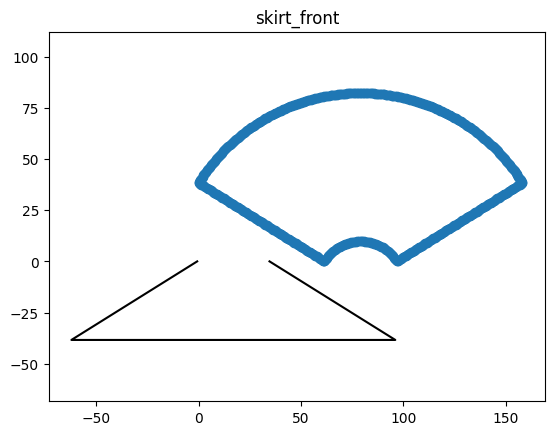

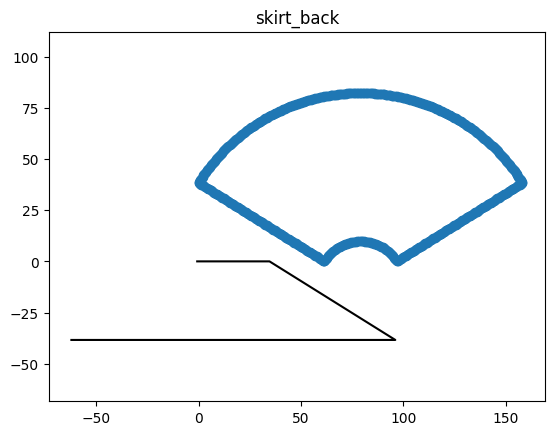

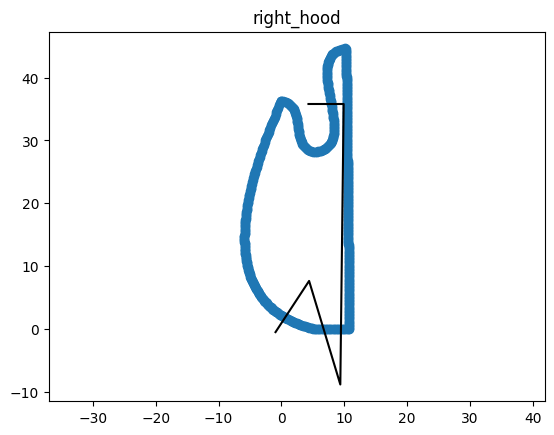

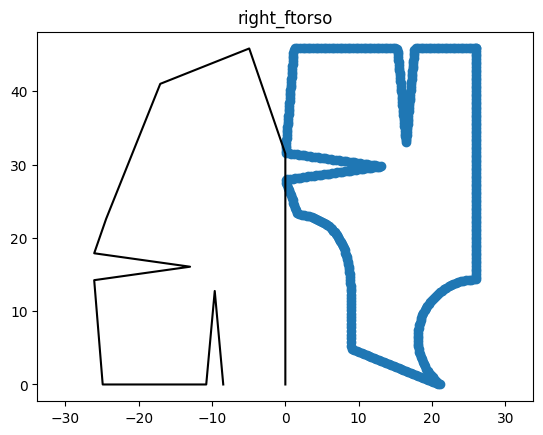

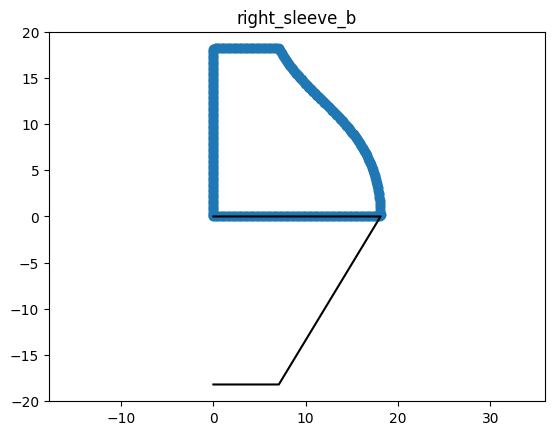

...

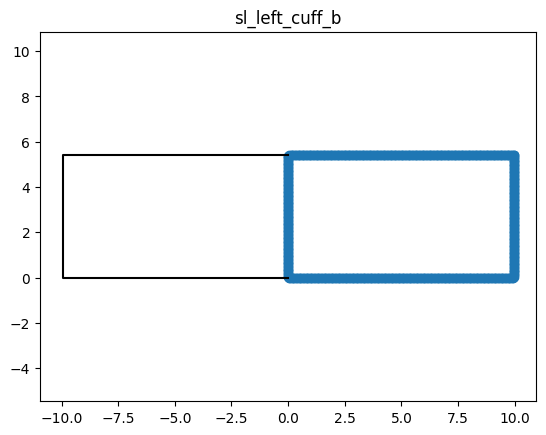

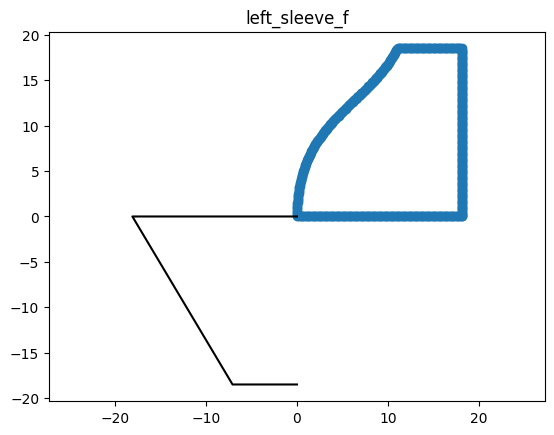

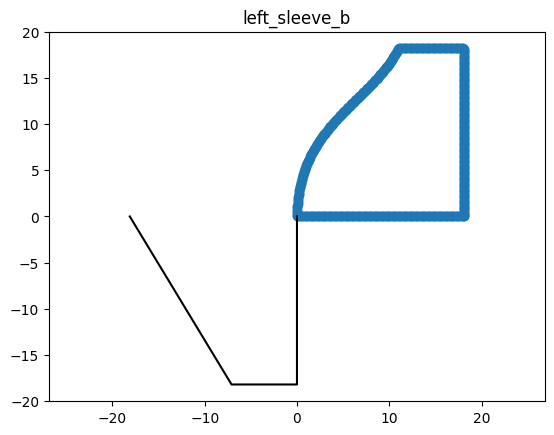

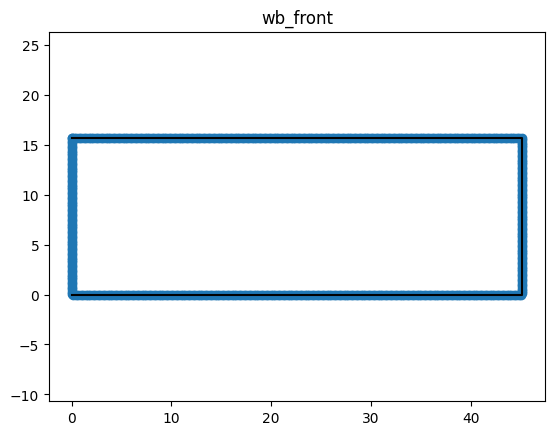

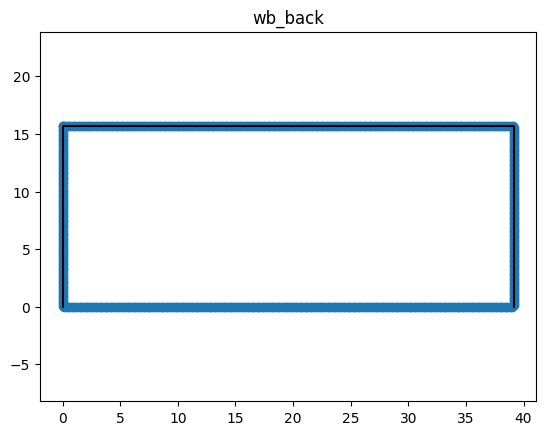

In [56]:
import svgpathtools as svgpath
from pygarment.pattern import utils

def _flip_y(point):
    """
        To get to image coordinates one might need to flip Y axis
    """
    flipped_point = list(point)  # top-level copy
    flipped_point[1] *= -1
    return flipped_point

def _verts_to_px_coords(vertices, translation_2d):
    """Convert given vertices and panel (2D) translation to px coordinate frame & units"""
    # Flip Y coordinate (in SVG Y looks down)
    vertices[:, 1] *= -1
    translation_2d[1] *= -1
    # Put upper left corner of the bounding box at zero
    offset = np.min(vertices, axis=0)
    vertices = vertices - offset
    translation_2d = translation_2d + offset
    return vertices, translation_2d


def _edge_as_curve(vertices, edge):
    start = vertices[edge['endpoints'][0]]
    end = vertices[edge['endpoints'][1]]
    if ('curvature' in edge):
        # NOTE: supports old curves
        if isinstance(edge['curvature'], list) or edge['curvature']['type'] == 'quadratic':  
            control_scale = _flip_y(edge['curvature'] if isinstance(edge['curvature'], list) else edge['curvature']['params'][0])
            control_point = utils.rel_to_abs_2d(start, end, control_scale)
            return svgpath.QuadraticBezier(*utils.list_to_c([start, control_point, end]))
        elif edge['curvature']['type'] == 'circle':  # Assuming circle
            # https://svgwrite.readthedocs.io/en/latest/classes/path.html#svgwrite.path.Path.push_arc

            radius, large_arc, right = edge['curvature']['params']

            return svgpath.Arc(
                utils.list_to_c(start), radius + 1j*radius,
                rotation=0,
                large_arc=large_arc, 
                sweep=not right,
                end=utils.list_to_c(end)
            )

        elif edge['curvature']['type'] == 'cubic':
            cps = []
            for p in edge['curvature']['params']:
                control_scale = _flip_y(p)
                control_point = utils.rel_to_abs_2d(start, end, control_scale)
                cps.append(control_point)

            return svgpath.CubicBezier(*utils.list_to_c([start, *cps, end]))

        else:
            raise ValueError(f'Unknown curvature type {edge["curvature"]["type"]}')

    else:
        return svgpath.Line(*utils.list_to_c([start, end]))


garment_id = os.path.basename(garment_path)
SPEC_FILE_PATH = os.path.join(garment_path, f"{garment_id}_specification.json")
pattern = pyg.pattern.wrappers.VisPattern(SPEC_FILE_PATH)

box_mesh = trimesh.load_mesh(
    os.path.join(garment_path, f"{garment_id}_boxmesh.ply"),
    process=False
)
idx_convert_map = v_id_map(box_mesh.vertices)
idx_convert_map_arr = np.array(idx_convert_map)

# Read Vertex Label
with open(os.path.join(garment_path, f"{garment_id}_sim_segmentation.txt"), "r") as f:
    segmentation = list(map(
        lambda x : x.strip(),
        f.readlines()
    ))

stitch_vertex_mask_dict = {}
for k in stitch_dict.keys():
    raw_mask = list(map(
        lambda x : True if f"stitch_{k}" in x.split(",") else False,
        segmentation
    ))
    base_mask = np.array(list(map(
        lambda idx : True if raw_mask[idx] else False,
        idx_convert_map
    )))
    stitch_vertex_mask_dict[k] = base_mask

with open(SPEC_FILE_PATH, "r") as f:
    spec = json.load(f)

lifted_panel_vertex_arr_list = []
# bbox_center_list = []
# for panel_name, panel in panel_svg_path_dict.items():
for panel_name, panel in spec['pattern']['panels'].items():

    euler_angles = spec['pattern']['panels'][panel_name]['rotation']
    translation = spec['pattern']['panels'][panel_name]['translation']
    rotation_matrix = euler_angles_to_rotation_matrix(euler_angles)

    vertices = np.asarray(panel['vertices'])
    
    vertices, translation = _verts_to_px_coords(
        vertices, 
        np.array(panel['translation'][:2]))   # Only XY

    
    segs = [_edge_as_curve(vertices, edge) for edge in panel['edges']]
    path = svgpath.Path(*segs)
    
    N_SAMPLE_POINTS = 500
    sample_points = np.array(list(map(
        lambda point : [path.point(point).real, path.point(point).imag],
        np.linspace(0, 1, N_SAMPLE_POINTS)
    )))
    
    x1, x2, y1, y2 = path.bbox()
    xm = (x1 + x2) / 2
    ym = (y1 + y2) / 2 
    
    plt.title(panel_name)
    plt.plot(sample_points[:, 0], sample_points[:, 1], 'o')
    
    plt.plot(
        np.asarray(panel['vertices'])[:, 0],
        np.asarray(panel['vertices'])[:, 1],
        '-',
        color='black'
    )
    plt.axis('equal')
    plt.show()

In [44]:
panel

(Path(Line(start=0j, end=(18.117238950508963+0j)),
      CubicBezier(start=(18.117238950508963+0j), control1=(18.008224307512876+9.975699377309166j), control2=(10.480849152257248+11.974606507809122j), end=(7.091744534163308+18.207114421941466j)),
      Line(start=(7.091744534163308+18.207114421941466j), end=18.207114421941466j),
      Line(start=18.207114421941466j, end=0j)),
 {'fill': 'rgb(227,175,186)',
  'stroke': 'rgb(51,51,51)',
  'stroke-width': '0.2'},
 False)

In [ ]:
box_mesh = trimesh.load_mesh(
    os.path.join(garment_path, f"{garment_id}_boxmesh.ply"),
    process=False
)
idx_convert_map = v_id_map(box_mesh.vertices)
idx_convert_map_arr = np.array(idx_convert_map)

# Read Vertex Label
with open(os.path.join(garment_path, f"{garment_id}_sim_segmentation.txt"), "r") as f:
    segmentation = list(map(
        lambda x : x.strip(),
        f.readlines()
    ))

stitch_vertex_mask_dict = {}
for k in stitch_dict.keys():
    raw_mask = list(map(
        lambda x : True if f"stitch_{k}" in x.split(",") else False,
        segmentation
    ))
    base_mask = np.array(list(map(
        lambda idx : True if raw_mask[idx] else False,
        idx_convert_map
    )))
    stitch_vertex_mask_dict[k] = base_mask

with open(SPEC_FILE_PATH, "r") as f:
    spec = json.load(f)

lifted_panel_vertex_arr_list = []
for panel_name, panel in panel_svg_path_dict.items():
# for panel_name, panel in panel_svg_path_dict.items():
    euler_angles = spec['pattern']['panels'][panel_name]['rotation']
    translation = spec['pattern']['panels'][panel_name]['translation']
    rotation_matrix = euler_angles_to_rotation_matrix(euler_angles)

    path = panel[0]
    x1, x2, y1, y2 = path.bbox()
    xm = (x1 + x2) / 2
    ym = (y1 + y2) / 2 
    
    
    vertices = np.array(list(map(
        lambda edge : [edge.start.real, edge.start.imag],
        path
    )))

    # vertices = np.array(spec['pattern']['panels'][panel_name]["vertices"])
    
    vertices = np.vstack([
        vertices,
        vertices[0]
    ])
    
    panel_vertex_arr = np.hstack([
        vertices,
        np.zeros((vertices.shape[0], 1))
    ]) @ rotation_matrix.T + translation
    
    lifted_panel_vertex_arr_list.append(panel_vertex_arr)
    

visualize_meshes_plotly(
    [box_mesh],
    show_edges=False,
    vertices_list=lifted_panel_vertex_arr_list + list(map(
        lambda mask : box_mesh.vertices[mask],
        stitch_vertex_mask_dict.values()
    )),

    vertices_color_list=[
        "black"
    ] * len(lifted_panel_vertex_arr_list) + [
        "yellow"
    ] * len(stitch_vertex_mask_dict.values())
)

In [ ]:
# Updated code to avoid duplicate transformations after SVG conversion

# Assuming 'path' is already transformed through SVG and provides the vertices
vertices = np.array(list(map(
    lambda edge: [edge.start.real, edge.start.imag],
    path
)))



# Visualization using plotly
visualize_meshes_plotly(
    [box_mesh],
    show_edges=False,
    vertices_list=lifted_panel_vertex_arr_list + list(map(
        lambda mask: box_mesh.vertices[mask],
        stitch_vertex_mask_dict.values()
    )),
    vertices_color_list=[
        "black"
    ] * len(lifted_panel_vertex_arr_list) + [
        "yellow"
    ] * len(stitch_vertex_mask_dict.values())
)


In [12]:

box_mesh = trimesh.load_mesh(
    os.path.join(garment_path, f"{garment_id}_boxmesh.ply"),
    process=False
)
idx_convert_map = v_id_map(box_mesh.vertices)
idx_convert_map_arr = np.array(idx_convert_map)

# Read Vertex Label
with open(os.path.join(garment_path, f"{garment_id}_sim_segmentation.txt"), "r") as f:
    segmentation = list(map(
        lambda x : x.strip(),
        f.readlines()
    ))

stitch_vertex_mask_dict = {}
for k in stitch_dict.keys():
    raw_mask = list(map(
        lambda x : True if f"stitch_{k}" in x.split(",") else False,
        segmentation
    ))
    base_mask = np.array(list(map(
        lambda idx : True if raw_mask[idx] else False,
        idx_convert_map
    )))
    stitch_vertex_mask_dict[k] = base_mask


with open(SPEC_FILE_PATH, "r") as f:
    spec = json.load(f)

lifted_panel_vertex_arr_list = []
for panel_name, panel in panel_svg_path_dict.items():
# for panel_name, panel in panel_svg_path_dict.items():
    euler_angles = spec['pattern']['panels'][panel_name]['rotation']
    translation = spec['pattern']['panels'][panel_name]['translation']
    rotation_matrix = euler_angles_to_rotation_matrix(euler_angles)


    path = panel[0]
    x1, x2, y1, y2 = path.bbox()
    xm = (x1 + x2) / 2
    ym = (y1 + y2) / 2
    
    
    vertices = np.array(list(map(
        lambda edge : [edge.start.real, edge.start.imag],
        path
    )))
    
    print(vertices)
    print()

    vertices = np.array(spec['pattern']['panels'][panel_name]["vertices"])
    
    print(vertices)
    print("-" * 100)
    print()
    
    vertices = np.vstack([
        vertices,
        vertices[0]
    ])
    
    panel_vertex_arr = np.hstack([
        vertices,
        np.zeros((vertices.shape[0], 1))
    ]) @ rotation_matrix.T + translation
    
    lifted_panel_vertex_arr_list.append(panel_vertex_arr)
    


[[ 0.          0.        ]
 [18.11723895  0.        ]
 [ 7.09174453 18.20711442]
 [ 0.         18.20711442]]

[[  0.           0.        ]
 [ 18.11723895   0.        ]
 [  7.09174453 -18.20711442]
 [  0.         -18.20711442]]
----------------------------------------------------------------------------------------------------

[[0.         5.39697   ]
 [0.         0.        ]
 [9.94996872 0.        ]
 [9.94996872 5.39697   ]]

[[0.         0.        ]
 [0.         5.39697   ]
 [9.94996872 5.39697   ]
 [9.94996872 0.        ]]
----------------------------------------------------------------------------------------------------

[[ 0.          0.        ]
 [ 0.         18.49353624]
 [ 7.09174453 18.49353624]
 [18.11723895  0.        ]]

[[  0.           0.        ]
 [  0.         -18.49353624]
 [  7.09174453 -18.49353624]
 [ 18.11723895   0.        ]]
----------------------------------------------------------------------------------------------------

[[0.         5.39697   ]
 [9.94996872

In [43]:
_ = """

with open(SPEC_FILE_PATH, "r") as f:
    spec = json.load(f)

lifted_panel_vertex_arr_list = []
for panel_name, panel in panel_svg_path_dict.items():
    euler_angles = spec['pattern']['panels'][panel_name]['rotation']
    translation = spec['pattern']['panels'][panel_name]['translation']
    rotation_matrix = euler_angles_to_rotation_matrix(euler_angles)


    path = panel[0]
    panel_vertex_arr = []
    for edge in path:
        start = edge.start
        stt = np.array([start.real, start.imag])
        #end = np.array([end.real, end.imag])
        
        panel_vertex_arr.append(stt)
    panel_vertex_arr = np.array(panel_vertex_arr)
    panel_vertex_arr = np.hstack([
        panel_vertex_arr,
        np.zeros((panel_vertex_arr.shape[0], 1))
    ]) @ rotation_matrix.T + translation
    
    lifted_panel_vertex_arr_list.append(panel_vertex_arr)
    

visualize_meshes_plotly(
    [box_mesh],
    show_edges=False,
    vertices_list=lifted_panel_vertex_arr_list,
    vertices_color_list=[
        [255, 0, 0] for _ in range(len(lifted_panel_vertex_arr_list))
    ]
)
"""

In [16]:
#TODO: wrappers.py에 대해 공부 하는 코드
# verts_to_px_coords

def _verts_to_px_coords(vertices, translation_2d):
    """Convert given vertices and panel (2D) translation to px coordinate frame & units"""
    # Flip Y coordinate (in SVG Y looks down)
    vertices[:, 1] *= -1
    translation_2d[1] *= -1
    # Put upper left corner of the bounding box at zero
    offset = np.min(vertices, axis=0)
    vertices = vertices - offset
    translation_2d = translation_2d + offset
    return vertices, translation_2d

In [41]:
# json load
with open(SPEC_FILE_PATH,"r") as f:
    json_data = json.load(f)

vertices= json_data['pattern']['panels']['skirt_front']['vertices']
transla = json_data['pattern']['panels']['skirt_front']['translation']

print(transla)






[-17.661140649932726, 80.10875348819373, 17.5]


In [42]:
panel_svg_path_dict['skirt_front']

(Path(Line(start=(61.454838977496586+0j), end=38.38062562742405j),
      Arc(start=38.38062562742405j, radius=(93.27779024461488+93.27779024461488j), rotation=0, large_arc=False, sweep=False, end=(158.23195925485862+38.38062562742405j)),
      Line(start=(158.23195925485862+38.38062562742405j), end=(96.77712027736203+0j)),
      Arc(start=(96.77712027736203+0j), radius=(20.822496046726815+20.822496046726815j), rotation=0, large_arc=False, sweep=True, end=(61.454838977496586+0j))),
 {'fill': 'rgb(227,175,186)',
  'stroke': 'rgb(51,51,51)',
  'stroke-width': '0.2'},
 True)